In [2]:
import pandas as pd
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from dnn_utils_v2 import sigmoid, sigmoid_backward, relu, relu_backward
from sklearn.model_selection import train_test_split
from tensorflow.keras.layers import Dense, BatchNormalization, Dropout


In [3]:
data = pd.read_csv('train.csv')

In [4]:
data.head()

,image,category
0,2823080.jpg,1
1,2870024.jpg,1
2,2662125.jpg,2
3,2900420.jpg,3
4,2804883.jpg,2


In [5]:
pip install opencv-python

Note: you may need to restart the kernel to use updated packages.


In [5]:
import cv2

In [6]:
sum(data['category']==1)

2120

In [7]:
data_x = data['image']
labels = data['category'].replace({1:1,2:0,3:0,4:0,5:0})

In [8]:
labels.unique()

array([1, 0])

In [50]:
# splitting the traindata into training and validation data
train_X,valid_X,train_Y,valid_Y = train_test_split(data_x,labels,test_size=0.2,train_size=0.8)
#train_X = data_x
#train_Y = labels

In [51]:
def pre_process(data): 
    data = data
    #x = np.array(data['image'])
    #la = np.array(data['category'])
    new = []
    for i in data:
        y = cv2.imread(i , 1)
        res = cv2.resize(y , (15,8))
        new.append(res)
    new = np.array(new)
    print(data.info())
    print(data.describe())
    return new

In [52]:
train_x = pre_process(train_X)

<class 'pandas.core.series.Series'>
Int64Index: 5001 entries, 1424 to 5339
Series name: image
Non-Null Count  Dtype 
--------------  ----- 
5001 non-null   object
dtypes: object(1)
memory usage: 78.1+ KB
None
count            5001
unique           5001
top       2731093.jpg
freq                1
Name: image, dtype: object


In [53]:
train_x.shape

(5001, 8, 15, 3)

In [16]:
train_y = train_Y.values

In [17]:
train_y.shape

(6252,)

In [21]:
import tensorflow as tf

In [25]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten, Dropout 
from tensorflow.keras import regularizers
from tensorflow.keras.callbacks import Callback
from tensorflow.keras.preprocessing import image
from tensorflow.keras.layers import Conv2D, MaxPooling2D
from tensorflow.keras.callbacks import ModelCheckpoint

In [ ]:
#1

In [235]:
nn_model = Sequential([
                    Flatten(input_shape = (8, 15,3)),
                    BatchNormalization(
        momentum=0.95, 
        epsilon=0.005,
        beta_initializer=tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.05), 
        gamma_initializer=tf.keras.initializers.Constant(value=0.9)
    ),
                    Dense(2, activation = 'relu', input_shape = (360,)),
BatchNormalization(
        momentum=0.95, 
        epsilon=0.005,
        beta_initializer=tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.05), 
        gamma_initializer=tf.keras.initializers.Constant(value=0.9)
    ),                    Dense(4, activation = 'relu'),
BatchNormalization(
        momentum=0.95, 
        epsilon=0.005,
        beta_initializer=tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.05), 
        gamma_initializer=tf.keras.initializers.Constant(value=0.9)
    ),                    Dense(1, activation = 'sigmoid')
])

In [236]:
# Compile the model
nn_model.compile(optimizer = 'adam',  
    loss = 'binary_crossentropy', 
    metrics = ['binary_accuracy'] )

In [237]:
checkpoint_path = 'model_checkpoints/checkpoint'
# Define the ModelCheckpoint callback
checkpoint1 = ModelCheckpoint(filepath=checkpoint_path,
 save_freq='epoch',
 save_weights_only=True,
 verbose=1)

In [54]:
nn_model = Sequential([
                    Flatten(input_shape = (8, 15,3)),
BatchNormalization(), 
    Dense(2, activation = 'relu', input_shape = (360,),kernel_regularizer=tf.keras.regularizers.l2(0.01)),
                            Dropout(0.5),#dropout rate 
    Dense(4, activation = 'relu'),
    BatchNormalization(),
    Dense(1, activation = 'sigmoid')
])
# Compile the model

nn_model.compile(optimizer = 'adam',  
    loss = 'binary_crossentropy', 
    metrics = ['binary_accuracy'] )
checkpoint_path = 'model_checkpoints/checkpoint'
# Define the ModelCheckpoint callback
checkpoint1 = ModelCheckpoint(filepath=checkpoint_path,
 save_freq='epoch',
 save_weights_only=True,
 verbose=1)
history = nn_model.fit(train_x,train_y , epochs=100, validation_split=0.15, batch_size=64,verbose=2,callbacks=[checkpoint1])
df1 = pd.DataFrame(history.history)


Epoch 1/100

Epoch 1: saving model to model_checkpoints/checkpoint
67/67 - 1s - loss: 0.7757 - binary_accuracy: 0.6071 - val_loss: 0.7224 - val_binary_accuracy: 0.5819 - 539ms/epoch - 8ms/step
Epoch 2/100

Epoch 2: saving model to model_checkpoints/checkpoint
67/67 - 0s - loss: 0.7079 - binary_accuracy: 0.6344 - val_loss: 0.6835 - val_binary_accuracy: 0.6591 - 97ms/epoch - 1ms/step
Epoch 3/100

Epoch 3: saving model to model_checkpoints/checkpoint
67/67 - 0s - loss: 0.6815 - binary_accuracy: 0.6480 - val_loss: 0.6754 - val_binary_accuracy: 0.6591 - 95ms/epoch - 1ms/step
Epoch 4/100

Epoch 4: saving model to model_checkpoints/checkpoint
67/67 - 0s - loss: 0.6731 - binary_accuracy: 0.6529 - val_loss: 0.6705 - val_binary_accuracy: 0.6578 - 87ms/epoch - 1ms/step
Epoch 5/100

Epoch 5: saving model to model_checkpoints/checkpoint
67/67 - 0s - loss: 0.6687 - binary_accuracy: 0.6560 - val_loss: 0.6686 - val_binary_accuracy: 0.6578 - 88ms/epoch - 1ms/step
Epoch 6/100

Epoch 6: saving model to m

67/67 - 0s - loss: 0.6441 - binary_accuracy: 0.6572 - val_loss: 0.6436 - val_binary_accuracy: 0.6578 - 78ms/epoch - 1ms/step
Epoch 44/100

Epoch 44: saving model to model_checkpoints/checkpoint
67/67 - 0s - loss: 0.6444 - binary_accuracy: 0.6572 - val_loss: 0.6440 - val_binary_accuracy: 0.6578 - 78ms/epoch - 1ms/step
Epoch 45/100

Epoch 45: saving model to model_checkpoints/checkpoint
67/67 - 0s - loss: 0.6443 - binary_accuracy: 0.6572 - val_loss: 0.6438 - val_binary_accuracy: 0.6578 - 79ms/epoch - 1ms/step
Epoch 46/100

Epoch 46: saving model to model_checkpoints/checkpoint
67/67 - 0s - loss: 0.6442 - binary_accuracy: 0.6572 - val_loss: 0.6433 - val_binary_accuracy: 0.6578 - 78ms/epoch - 1ms/step
Epoch 47/100

Epoch 47: saving model to model_checkpoints/checkpoint
67/67 - 0s - loss: 0.6438 - binary_accuracy: 0.6572 - val_loss: 0.6433 - val_binary_accuracy: 0.6578 - 78ms/epoch - 1ms/step
Epoch 48/100

Epoch 48: saving model to model_checkpoints/checkpoint
67/67 - 0s - loss: 0.6444 - bi

Epoch 86/100

Epoch 86: saving model to model_checkpoints/checkpoint
67/67 - 0s - loss: 0.6444 - binary_accuracy: 0.6572 - val_loss: 0.6437 - val_binary_accuracy: 0.6578 - 81ms/epoch - 1ms/step
Epoch 87/100

Epoch 87: saving model to model_checkpoints/checkpoint
67/67 - 0s - loss: 0.6444 - binary_accuracy: 0.6572 - val_loss: 0.6439 - val_binary_accuracy: 0.6578 - 79ms/epoch - 1ms/step
Epoch 88/100

Epoch 88: saving model to model_checkpoints/checkpoint
67/67 - 0s - loss: 0.6444 - binary_accuracy: 0.6572 - val_loss: 0.6439 - val_binary_accuracy: 0.6578 - 78ms/epoch - 1ms/step
Epoch 89/100

Epoch 89: saving model to model_checkpoints/checkpoint
67/67 - 0s - loss: 0.6437 - binary_accuracy: 0.6572 - val_loss: 0.6441 - val_binary_accuracy: 0.6578 - 79ms/epoch - 1ms/step
Epoch 90/100

Epoch 90: saving model to model_checkpoints/checkpoint
67/67 - 0s - loss: 0.6436 - binary_accuracy: 0.6572 - val_loss: 0.6443 - val_binary_accuracy: 0.6578 - 79ms/epoch - 1ms/step
Epoch 91/100

Epoch 91: saving

In [45]:
#history = nn_model.fit(train_x,train_y , epochs=100, validation_split=0.15, batch_size=64,callbacks=[checkpoint1])
#df1 = pd.DataFrame(history.history)

Epoch 1/100
45/84 [===============>..............] - ETA: 0s - loss: 0.6288 - binary_accuracy: 0.6642
Epoch 1: saving model to model_checkpoints/checkpoint
84/84 [==============================] - 0s 2ms/step - loss: 0.6356 - binary_accuracy: 0.6584 - val_loss: 0.6280 - val_binary_accuracy: 0.6748
Epoch 2/100
58/84 [===================>..........] - ETA: 0s - loss: 0.6370 - binary_accuracy: 0.6565
Epoch 2: saving model to model_checkpoints/checkpoint
84/84 [==============================] - 0s 1ms/step - loss: 0.6354 - binary_accuracy: 0.6584 - val_loss: 0.6272 - val_binary_accuracy: 0.6748
Epoch 3/100
56/84 [===================>..........] - ETA: 0s - loss: 0.6328 - binary_accuracy: 0.6582
Epoch 3: saving model to model_checkpoints/checkpoint
84/84 [==============================] - 0s 1ms/step - loss: 0.6320 - binary_accuracy: 0.6584 - val_loss: 0.6249 - val_binary_accuracy: 0.6748
Epoch 4/100
54/84 [==================>...........] - ETA: 0s - loss: 0.6290 - binary_accuracy: 0.6612
E

55/84 [==================>...........] - ETA: 0s - loss: 0.6269 - binary_accuracy: 0.6662
Epoch 28: saving model to model_checkpoints/checkpoint
84/84 [==============================] - 0s 1ms/step - loss: 0.6321 - binary_accuracy: 0.6584 - val_loss: 0.6270 - val_binary_accuracy: 0.6748
Epoch 29/100
54/84 [==================>...........] - ETA: 0s - loss: 0.6299 - binary_accuracy: 0.6620
Epoch 29: saving model to model_checkpoints/checkpoint
84/84 [==============================] - 0s 1ms/step - loss: 0.6310 - binary_accuracy: 0.6584 - val_loss: 0.6271 - val_binary_accuracy: 0.6748
Epoch 30/100
55/84 [==================>...........] - ETA: 0s - loss: 0.6307 - binary_accuracy: 0.6520
Epoch 30: saving model to model_checkpoints/checkpoint
84/84 [==============================] - 0s 1ms/step - loss: 0.6283 - binary_accuracy: 0.6584 - val_loss: 0.6241 - val_binary_accuracy: 0.6748
Epoch 31/100
56/84 [===================>..........] - ETA: 0s - loss: 0.6325 - binary_accuracy: 0.6551
Epoch 3

81/84 [===========================>..] - ETA: 0s - loss: 0.6332 - binary_accuracy: 0.6603
Epoch 55: saving model to model_checkpoints/checkpoint
84/84 [==============================] - 0s 2ms/step - loss: 0.6341 - binary_accuracy: 0.6584 - val_loss: 0.6257 - val_binary_accuracy: 0.6748
Epoch 56/100
52/84 [=================>............] - ETA: 0s - loss: 0.6361 - binary_accuracy: 0.6514
Epoch 56: saving model to model_checkpoints/checkpoint
84/84 [==============================] - 0s 1ms/step - loss: 0.6329 - binary_accuracy: 0.6584 - val_loss: 0.6226 - val_binary_accuracy: 0.6748
Epoch 57/100
56/84 [===================>..........] - ETA: 0s - loss: 0.6332 - binary_accuracy: 0.6627
Epoch 57: saving model to model_checkpoints/checkpoint
84/84 [==============================] - 0s 1ms/step - loss: 0.6359 - binary_accuracy: 0.6584 - val_loss: 0.6272 - val_binary_accuracy: 0.6748
Epoch 58/100
58/84 [===================>..........] - ETA: 0s - loss: 0.6340 - binary_accuracy: 0.6589
Epoch 5

58/84 [===================>..........] - ETA: 0s - loss: 0.6351 - binary_accuracy: 0.6538
Epoch 82: saving model to model_checkpoints/checkpoint
84/84 [==============================] - 0s 1ms/step - loss: 0.6347 - binary_accuracy: 0.6584 - val_loss: 0.6260 - val_binary_accuracy: 0.6748
Epoch 83/100
54/84 [==================>...........] - ETA: 0s - loss: 0.6353 - binary_accuracy: 0.6589
Epoch 83: saving model to model_checkpoints/checkpoint
84/84 [==============================] - 0s 1ms/step - loss: 0.6366 - binary_accuracy: 0.6584 - val_loss: 0.6296 - val_binary_accuracy: 0.6748
Epoch 84/100
59/84 [====================>.........] - ETA: 0s - loss: 0.6342 - binary_accuracy: 0.6629
Epoch 84: saving model to model_checkpoints/checkpoint
84/84 [==============================] - 0s 1ms/step - loss: 0.6361 - binary_accuracy: 0.6584 - val_loss: 0.6292 - val_binary_accuracy: 0.6748
Epoch 85/100
56/84 [===================>..........] - ETA: 0s - loss: 0.6309 - binary_accuracy: 0.6635
Epoch 8

In [55]:
df1

,loss,binary_accuracy,val_loss,val_binary_accuracy
0,0.775701,0.607059,0.722372,0.581891
1,0.707850,0.634353,0.683495,0.659121
2,0.681527,0.648000,0.675400,0.659121
3,0.673101,0.652941,0.670533,0.657790
4,0.668719,0.656000,0.668616,0.657790
...,...,...,...,...
95,0.644995,0.657176,0.645185,0.657790
96,0.644476,0.657176,0.644940,0.657790
97,0.644353,0.657176,0.644161,0.657790
98,0.644187,0.657176,0.644222,0.657790


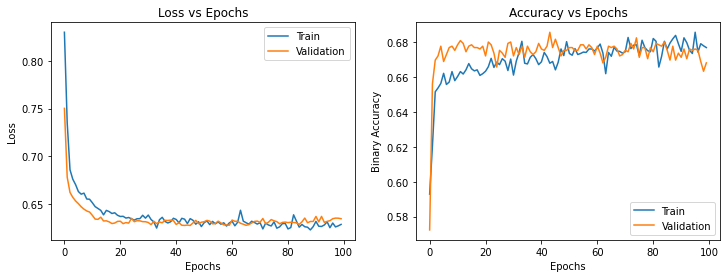

In [31]:
# Plot the training and validation loss
frame = pd.DataFrame(history.history)
epochs = np.arange(len(frame))
fig = plt.figure(figsize=(12,4))
# Loss plot
ax = fig.add_subplot(121)
ax.plot(epochs, frame['loss'], label="Train")
ax.plot(epochs, frame['val_loss'], label="Validation")
ax.set_xlabel("Epochs")
ax.set_ylabel("Loss")
ax.set_title("Loss vs Epochs")
ax.legend()
# Accuracy plot
ax = fig.add_subplot(122)
ax.plot(epochs, frame['binary_accuracy'], label="Train")
ax.plot(epochs, frame['val_binary_accuracy'], label="Validation")
ax.set_xlabel("Epochs")
ax.set_ylabel("Binary Accuracy")
ax.set_title("Accuracy vs Epochs")
ax.legend()

In [ ]:
#2

In [273]:
model_cnn = Sequential([
 Conv2D(6, (3, 3), activation='relu', input_shape=(8, 15,3)),
 MaxPooling2D(pool_size=(2,2), strides=(1,1), padding='valid'),
 Conv2D(6, (3, 3), activation='relu'),
 MaxPooling2D(pool_size=(2,2), strides=(1,1), padding='valid'),
 Flatten(),
 Dense(4, activation='relu'),
 Dense(1, activation='sigmoid')
])

In [274]:
model_cnn.compile(optimizer='adam',
 loss='binary_crossentropy',
 metrics=['accuracy'])

In [275]:
checkpoint_path_cnn = 'cnn_checkpoints/checkpoint'
# Define the ModelCheckpoint callback
checkpoint_cnn = ModelCheckpoint(filepath=checkpoint_path_cnn,
 save_freq='epoch',
 save_weights_only=True,
 verbose=1)

In [276]:
history = model_cnn.fit( train_x, train_y, epochs = 100, validation_split = 0.15,batch_size = 256, verbose = 2,
                       callbacks=[checkpoint_cnn])

Epoch 1/100

Epoch 1: saving model to cnn_checkpoints/checkpoint
17/17 - 0s - loss: 2.7743 - accuracy: 0.4054 - val_loss: 0.6743 - val_accuracy: 0.6778 - 479ms/epoch - 28ms/step
Epoch 2/100

Epoch 2: saving model to cnn_checkpoints/checkpoint
17/17 - 0s - loss: 0.6650 - accuracy: 0.6631 - val_loss: 0.6477 - val_accuracy: 0.6778 - 141ms/epoch - 8ms/step
Epoch 3/100

Epoch 3: saving model to cnn_checkpoints/checkpoint
17/17 - 0s - loss: 0.6457 - accuracy: 0.6628 - val_loss: 0.6387 - val_accuracy: 0.6778 - 131ms/epoch - 8ms/step
Epoch 4/100

Epoch 4: saving model to cnn_checkpoints/checkpoint
17/17 - 0s - loss: 0.6455 - accuracy: 0.6628 - val_loss: 0.6376 - val_accuracy: 0.6778 - 112ms/epoch - 7ms/step
Epoch 5/100

Epoch 5: saving model to cnn_checkpoints/checkpoint
17/17 - 0s - loss: 0.6439 - accuracy: 0.6628 - val_loss: 0.6369 - val_accuracy: 0.6778 - 113ms/epoch - 7ms/step
Epoch 6/100

Epoch 6: saving model to cnn_checkpoints/checkpoint
17/17 - 0s - loss: 0.6429 - accuracy: 0.6628 - va

Epoch 47/100

Epoch 47: saving model to cnn_checkpoints/checkpoint
17/17 - 0s - loss: 0.6253 - accuracy: 0.6628 - val_loss: 0.6141 - val_accuracy: 0.6764 - 104ms/epoch - 6ms/step
Epoch 48/100

Epoch 48: saving model to cnn_checkpoints/checkpoint
17/17 - 0s - loss: 0.6246 - accuracy: 0.6628 - val_loss: 0.6155 - val_accuracy: 0.6778 - 104ms/epoch - 6ms/step
Epoch 49/100

Epoch 49: saving model to cnn_checkpoints/checkpoint
17/17 - 0s - loss: 0.6314 - accuracy: 0.6628 - val_loss: 0.6150 - val_accuracy: 0.6764 - 120ms/epoch - 7ms/step
Epoch 50/100

Epoch 50: saving model to cnn_checkpoints/checkpoint
17/17 - 0s - loss: 0.6254 - accuracy: 0.6628 - val_loss: 0.6144 - val_accuracy: 0.6764 - 116ms/epoch - 7ms/step
Epoch 51/100

Epoch 51: saving model to cnn_checkpoints/checkpoint
17/17 - 0s - loss: 0.6233 - accuracy: 0.6628 - val_loss: 0.6255 - val_accuracy: 0.6764 - 105ms/epoch - 6ms/step
Epoch 52/100

Epoch 52: saving model to cnn_checkpoints/checkpoint
17/17 - 0s - loss: 0.6219 - accuracy: 

Epoch 93/100

Epoch 93: saving model to cnn_checkpoints/checkpoint
17/17 - 0s - loss: 0.5993 - accuracy: 0.6835 - val_loss: 0.5890 - val_accuracy: 0.7150 - 104ms/epoch - 6ms/step
Epoch 94/100

Epoch 94: saving model to cnn_checkpoints/checkpoint
17/17 - 0s - loss: 0.5978 - accuracy: 0.6864 - val_loss: 0.5890 - val_accuracy: 0.7097 - 101ms/epoch - 6ms/step
Epoch 95/100

Epoch 95: saving model to cnn_checkpoints/checkpoint
17/17 - 0s - loss: 0.5957 - accuracy: 0.6887 - val_loss: 0.5884 - val_accuracy: 0.7004 - 99ms/epoch - 6ms/step
Epoch 96/100

Epoch 96: saving model to cnn_checkpoints/checkpoint
17/17 - 0s - loss: 0.5987 - accuracy: 0.6781 - val_loss: 0.5856 - val_accuracy: 0.7084 - 103ms/epoch - 6ms/step
Epoch 97/100

Epoch 97: saving model to cnn_checkpoints/checkpoint
17/17 - 0s - loss: 0.5975 - accuracy: 0.6833 - val_loss: 0.5914 - val_accuracy: 0.7164 - 104ms/epoch - 6ms/step
Epoch 98/100

Epoch 98: saving model to cnn_checkpoints/checkpoint
17/17 - 0s - loss: 0.5950 - accuracy: 0

In [277]:
df2 = pd.DataFrame(history.history)

In [278]:
df2.sort_values(by=['accuracy','val_accuracy'],ascending=False)

,loss,accuracy,val_loss,val_accuracy
99,0.597456,0.691765,0.586624,0.703063
97,0.594982,0.690588,0.583991,0.711052
98,0.592463,0.690588,0.583665,0.705726
94,0.595718,0.688706,0.588415,0.700399
91,0.601453,0.688000,0.589245,0.709720
...,...,...,...,...
55,0.618108,0.662824,0.624418,0.676431
56,0.618257,0.662824,0.617813,0.676431
57,0.617180,0.662824,0.615577,0.676431
78,0.608892,0.662588,0.593414,0.677763


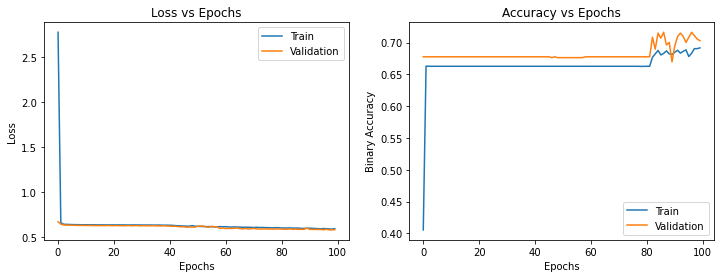

In [279]:
# Plot the training and validation loss
frame = pd.DataFrame(history.history)
epochs = np.arange(len(frame))
fig = plt.figure(figsize=(12,4))
# Loss plot
ax = fig.add_subplot(121)
ax.plot(epochs, frame['loss'], label="Train")
ax.plot(epochs, frame['val_loss'], label="Validation")
ax.set_xlabel("Epochs")
ax.set_ylabel("Loss")
ax.set_title("Loss vs Epochs")
ax.legend()
# Accuracy plot
ax = fig.add_subplot(122)
ax.plot(epochs, frame['accuracy'], label="Train")
ax.plot(epochs, frame['val_accuracy'], label="Validation")
ax.set_xlabel("Epochs")
ax.set_ylabel("Binary Accuracy")
ax.set_title("Accuracy vs Epochs")
ax.legend()

In [ ]:
#3

In [19]:
from init_utils import sigmoid, relu, compute_loss, forward_propagation, backward_propagation
from init_utils import update_parameters, load_dataset,predict, plot_decision_boundary, predict_dec

In [144]:
model1 = Sequential([
                    Flatten(input_shape = (8, 15,3)),
                    BatchNormalization(
        momentum=0.95, 
        epsilon=0.005,
        beta_initializer=tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.05), 
        gamma_initializer=tf.keras.initializers.Constant(value=0.9)
    ),
                    Dense(2, activation = 'relu', input_shape = (360,)),
BatchNormalization(
        momentum=0.95, 
        epsilon=0.005,
        beta_initializer=tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.05), 
        gamma_initializer=tf.keras.initializers.Constant(value=0.9)
    ),                    Dense(4, activation = 'relu'),
BatchNormalization(
        momentum=0.95, 
        epsilon=0.005,
        beta_initializer=tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.05), 
        gamma_initializer=tf.keras.initializers.Constant(value=0.9)
    ),                    Dense(1, activation = 'sigmoid')
])

In [34]:
nn_model = Sequential([
                    Flatten(input_shape = (8, 15,3)),
BatchNormalization(), 
    Dense(2, activation = 'relu', input_shape = (360,),kernel_regularizer=tf.keras.regularizers.l2(0.01)),
                            Dropout(0.5),#dropout rate 
    Dense(4, activation = 'relu'),
    BatchNormalization(),
    Dense(1, activation = 'sigmoid')
])

In [145]:
# Compile the model
model1.compile(optimizer = 'adam',  
    loss = 'binary_crossentropy', 
    metrics = ['binary_accuracy'] )

In [35]:
# Compile the model
nn_model.compile(optimizer = 'adam',  
    loss = 'binary_crossentropy', 
    metrics = ['binary_accuracy'] )

In [146]:
model1.load_weights(checkpoint_path)

In [36]:
nn_model.load_weights(checkpoint_path)

In [313]:
model2 = Sequential([
 Conv2D(6, (3, 3), activation='relu', input_shape=(8, 15,3)),
 MaxPooling2D(pool_size=(2,2), strides=(1,1), padding='valid'),
 Conv2D(6, (3, 3), activation='relu'),
 MaxPooling2D(pool_size=(2,2), strides=(1,1), padding='valid'),
 Flatten(),
 Dense(4, activation='relu'),
 Dense(1, activation='sigmoid')
])

In [314]:
model2.compile(optimizer='adam',
 loss='binary_crossentropy',
 metrics=['accuracy'])

In [315]:
model2.load_weights(checkpoint_path_cnn)

In [316]:
train_y.shape

(5001,)

In [38]:
test_data = pd.read_csv('test.csv')
x = test_data['image']
test_x = []
for i in x:
    y = cv2.imread(i , 1)
    res = cv2.resize(y , (15,8))
    test_x.append(res)
test_x = np.array(test_x)

In [318]:
test_x.shape

(2680, 8, 15, 3)

In [320]:
i = np.random.randint(low=0, high=test_x.shape[0], size=5)

In [321]:
i 1,0,0,1,1

array([1775,  136,  474, 1550,  745])

In [335]:
idx = np.array([ 1775,  136,  474, 1550,  745])

In [336]:
test_x = test_x[idx]

In [339]:
test_x.shape

(2680, 8, 15, 3)

84/84 [==============================] - 0s 473us/step


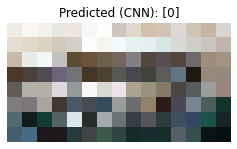

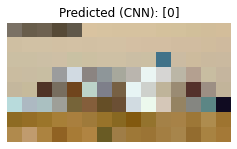

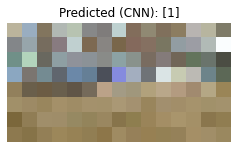

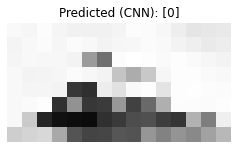

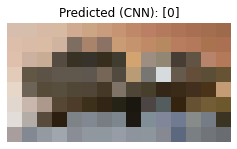

...

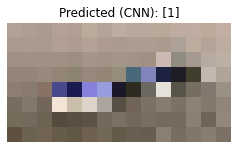

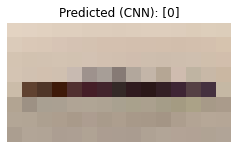

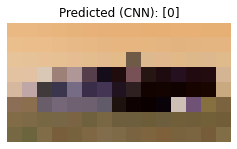

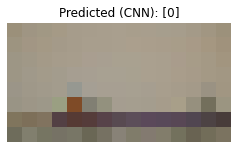

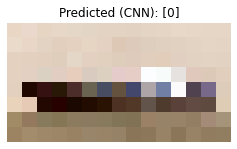

In [39]:
#model1_preds = model1.predict(test_x)
#model1_preds = np.where(model1_preds > 0.5, 1, 0)
model2_preds = nn_model.predict(test_x)
model2_preds = np.where(model2_preds > 0.5, 1, 0)
for i in range(test_x.shape[0]):
    plt.figure(figsize=(4,4))
    plt.imshow(test_x[i])
    plt.title(f"Predicted (CNN): {model2_preds[i]}")
    plt.axis('off')
    plt.show()

84/84 [==============================] - 0s 808us/step


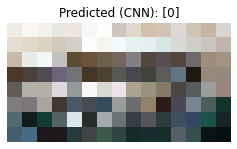

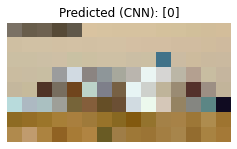

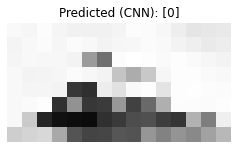

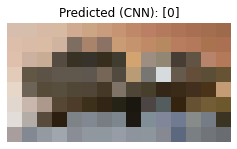

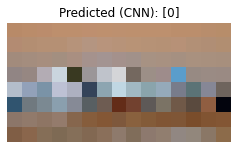

...

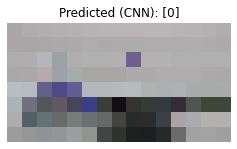

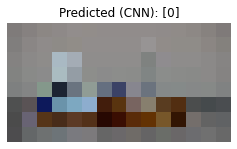

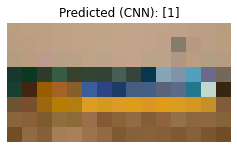

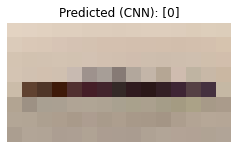

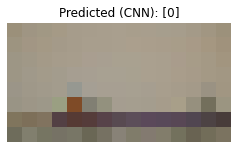

In [341]:
#model1_preds = model1.predict(test_x)
#model1_preds = np.where(model1_preds > 0.5, 1, 0)
model2_preds = model2.predict(test_x)
model2_preds = np.where(model2_preds > 0.5, 1, 0)
for i in range(test_x.shape[0]):
    plt.figure(figsize=(4,4))
    plt.imshow(test_x[i])
    plt.title(f"Predicted (CNN): {model2_preds[i]}")
    plt.axis('off')
    plt.show()

In [41]:
test_labels = pd.read_excel('test_labels.xlsx')

In [43]:
test_labels

,Unnamed: 0,category
0,0,0
1,1,0
2,2,0
3,3,0
4,4,0
...,...,...
2675,2675,0
2676,2676,0
2677,2677,0
2678,2678,0


In [42]:
np.sum(model2_preds.reshape(2680)!=np.array(test_labels['category']))

913

In [ ]:
67.91%

In [328]:
test_data = pd.read_csv('test.csv')
x = test_data['image']
test_x = []
for i in x:
    y = cv2.imread(i , 1)
    res = cv2.resize(y , (255,255))
    test_x.append(res)
test_x = np.array(test_x)

In [303]:
i = np.random.randint(low=0, high=test_x.shape[0], size=5)

In [329]:
idx = np.array([1775,  136,  474, 1550,  745])

In [330]:
test_x = test_x[idx]

In [331]:
for i in range(5):
    plt.figure(figsize=(10,10))
    plt.imshow(test_x[i])
    plt.axis('off')
    plt.show()

In [256]:
sum(labels==0)

4132

Both the models gave a similar accuracy for the validation set, however CNN gave a higher accuracy on 
the training set but there is a possibility for overfitting in cnn. An improvement in accuracy could be achieved 
by more training examples with a class balance of cargo and non cargo ship images. For now, the model doesn't 
seem to identify the features of the ship accurately.
